In [1]:
import geopandas as gpd
import glob
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import pandas as pd 
from pathlib import Path
import seaborn as sns

In [2]:
## --- Data locations
# Image save location
save_path = Path('/Users/wmk934/data/perceptual_models/img')

# Data location
agg_level = '10' # Aggregation level of the shapefiles, 1 to 10 (10 coarsest, 1 finest)
pfaf_path = Path('/Users/wmk934/data/Global_geospatial/MERIT_Hydro_basins/pfafstetter/aggregate/')
pfaf_files = glob.glob(str(pfaf_path) + f'/aggBasin_{agg_level}_G7*.shp')

zonal_path = Path('/Users/wmk934/data/perceptual_models/data/zonal_stats/')
pfaf_to_merit_file = 'agg_pfaf_to_merit_orig.shp'
csv_file = 'zonal_stats.csv'

In [53]:
## --- Data loading
# Load the shapefiles
pfafs = []
for file in pfaf_files:
    gdf = gpd.read_file(file)
    
    # We'll assign colors now, while we have the file handle available
    # This is easier than assigning them later based on the Pfaf codes,
    # since the Pfaf codes are not consistent across files:
    # - Most files have either 'L0C1xxxxx' 
    # - Endorheic basins have 'L0E0xxxxx' > These are 0, by convention
    # - Pfaf 8 only has field 'L0C'
    # - Pfaf 4 only has field 'L0'
    # - Pfaf 2 only has field 'L0'
    # - Pfaf 1 has a null field
    cat = Path(file).stem[-1] # Should be 1-9 or E
    if cat == 'E':
        gdf['color'] = 0 # Endorheic
    else:
        gdf['color'] = int(cat)
    pfafs.append(gdf)
pfaf = pd.concat(pfafs, ignore_index=True)
merit = gpd.read_file(zonal_path / pfaf_to_merit_file)

# Get the csv
stats = pd.read_csv(zonal_path / csv_file)

In [74]:
## --- Add some useful values to stats
# Create a majority IGBP landclass column
stats['igbp_mode'] = stats[['igbp_1', 'igbp_2', 'igbp_3', 'igbp_4', 'igbp_5',
                           'igbp_6', 'igbp_7', 'igbp_8', 'igbp_9', 'igbp_10', 'igbp_11', 'igbp_12',
                           'igbp_13', 'igbp_14', 'igbp_15', 'igbp_16', 'igbp_17', 'igbp_255']].idxmax(axis=1).str.extract(r'igbp_(\d+)').astype(int)

# Create a majority LGRIP agriculture class column
mapping_dict = {'lg_water': 0, 'lg_non-cro': 1, 'lg_irrigat': 2, 'lg_rainfed': 3}
stats['lgrip_mode'] = stats[['lg_water', 'lg_non-cro', 'lg_irrigat', 'lg_rainfed']].idxmax(axis=1).map(mapping_dict)

In [54]:
## --- Plotting prep
# Colors for each Pfaf region
colors = [
    (166, 206, 227), # Light blue
    ( 31, 120, 180), # Blue
    (178, 223, 138), # Light green
    ( 51, 160,  44), # Green
    (251, 154, 153), # Light red
    (227,  26,  28), # Red
    (253, 191, 111), # Light orange
    (255, 127,   0), # Orange
    (202, 178, 214), # Light purple
    (106,  61, 154), # Purple
    (190, 190, 190)  # Grey (no data)
]
colors_normalized = [(r / 255, g / 255, b / 255) for r, g, b in colors] # Normalize RGB values to range [0, 1]
cmap_full = ListedColormap(colors_normalized) # Create a colormap from the custom colors
cmap_pfaf = ListedColormap(colors_normalized[:10]) # Create a colormap from the custom colors, excluding grey

# FIG 1
# Check for which small Merit basins we have Pfaf codes
no_pfaf = (merit['pfaf'] == 'not assigned')

# Create a mock dataframe to get the correct color legend
cdf = gpd.GeoDataFrame({'color': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 'No Pfaf']},
                       geometry=gpd.points_from_xy([-100] * 11, [25] * 11))

# FIG 2:
# Assign color to the csv
stats['Pfafstetter'] = stats['pfaf'].apply(lambda x: x[3] if x.lower() != 'not assigned' else 'N')

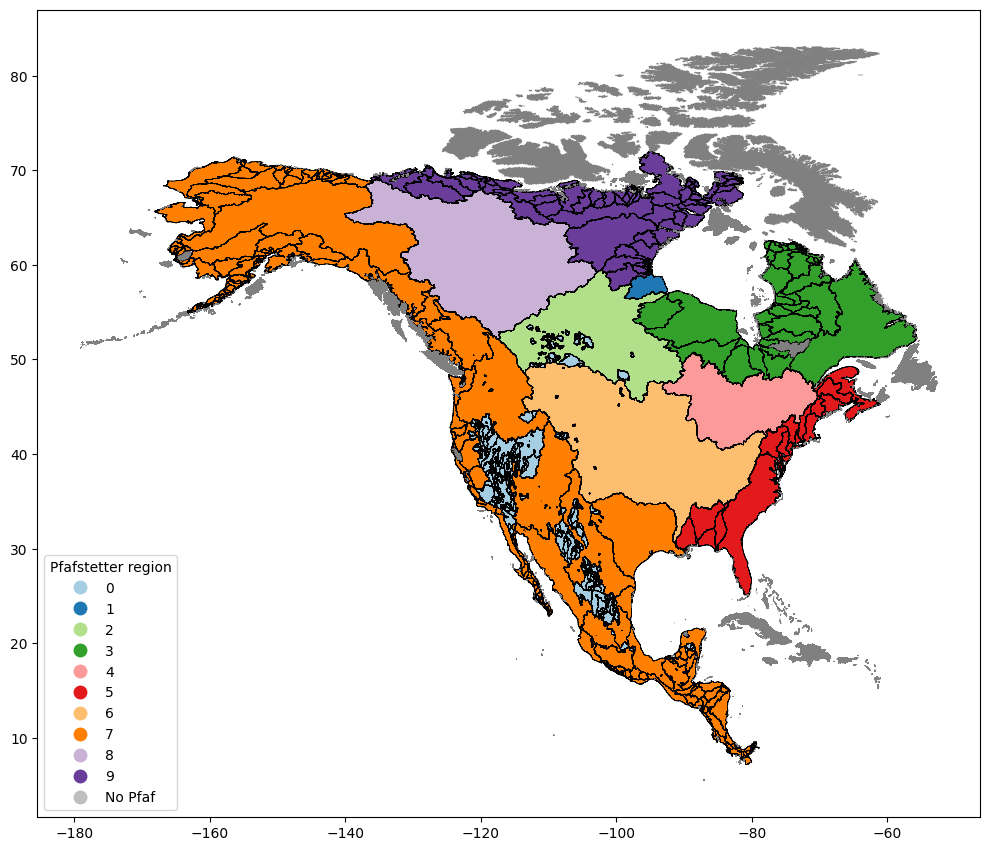

In [60]:
### --- Plotting
# FIG 1: Pfafstetter regions
fig, ax = plt.subplots(1,1,figsize=(10, 10))

cdf.plot(ax=ax,  column='color', cmap=cmap_full, categorical=True, legend=True, legend_kwds={'loc': 'lower left', 'title': 'Pfafstetter region'})
pfaf.plot(ax=ax, column='color', cmap=cmap_pfaf, categorical=True, edgecolor='k', linewidth=0.5)
merit[no_pfaf].plot(ax=ax, color='grey', edgecolor='grey', linewidth=0.25) # merit second, plot only regions w/o Pfaf code

plt.tight_layout()
plt.savefig(save_path / 'pfafstetter_regions.png', dpi=300, bbox_inches='tight')

In [7]:
# FIG 2: correlation checks
stats_corr = stats.drop(columns=['COMID','unitarea','unitarea.1','unitarea.2','unitarea.3','pfaf','Pfafstetter'],axis=1)
corr = stats_corr.corr()

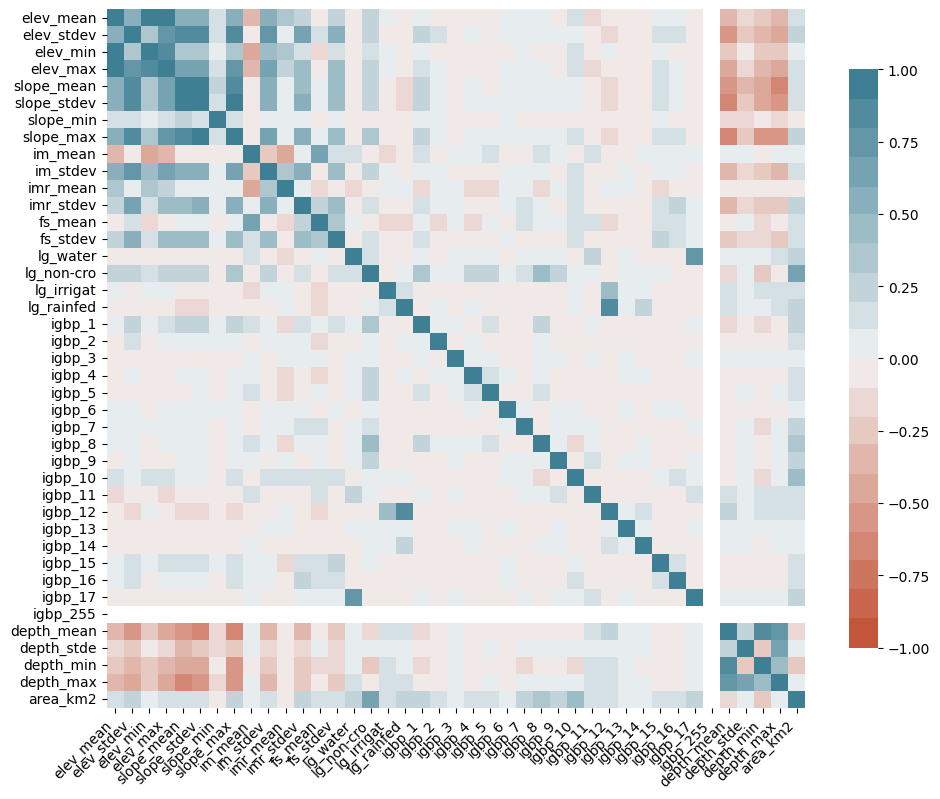

In [28]:
fig,ax = plt.subplots(1,1,figsize=(10,10))

# correlations
sns.heatmap(
    corr,
    ax=ax,
    vmin=-1, vmax=1, center=0,
    cmap=sns.diverging_palette(20, 220, n=20),
    square=True,
    xticklabels=True, yticklabels=True,
    cbar_kws={'shrink': 0.6}
)
ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation=45,
    horizontalalignment='right'
);

plt.tight_layout()
plt.savefig(save_path / 'descriptor_correlations.png', dpi=300, bbox_inches='tight')

In [16]:
# FIG 3: pairplot
sns.pairplot(stats_corr)
plt.savefig(save_path / 'pairplot.png', dpi=300, bbox_inches='tight')

In [12]:
# FIG 4: boxplots per Pfafstetter region
def plot_grouped_histogram(df,sortby,plot_column,colors,ax,label):
    # Clean and sort data
    df = df.sort_values(by=sortby)
    
    # plotting properties
    flierprops = dict(marker='.', markerfacecolor='black', markersize=3, markeredgecolor='black')
    
    # plot
    sns.boxplot(ax=ax,
                data=df, y=sortby, x=plot_column,
                width=0.7,
                dodge=False, hue=sortby, palette=colors,
                flierprops=flierprops)
    ax.set_xlabel(label)
    ax.set_title(plot_column)

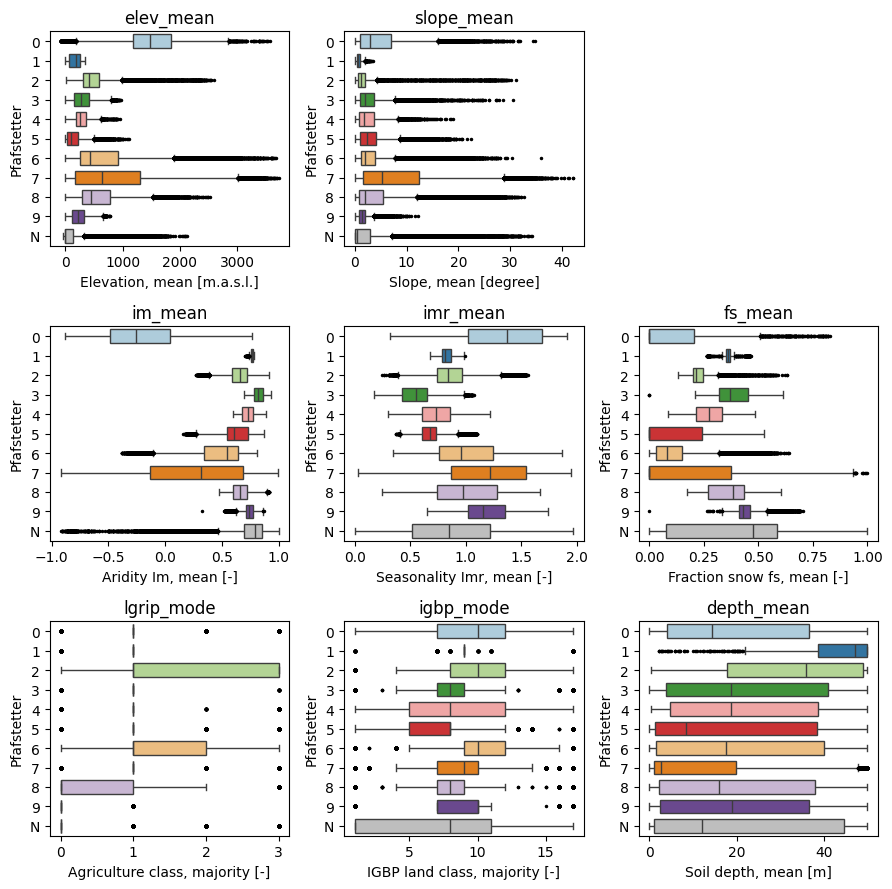

In [59]:
fig,axs = plt.subplots(3,3,figsize=(9,9))
plot_grouped_histogram(stats, 'Pfafstetter', 'elev_mean',  colors_normalized,axs[0,0], 'Elevation, mean [m.a.s.l.]')
plot_grouped_histogram(stats, 'Pfafstetter', 'slope_mean', colors_normalized,axs[0,1], 'Slope, mean [degree]')
axs[0,2].set_visible(False)

plot_grouped_histogram(stats, 'Pfafstetter', 'im_mean',    colors_normalized,axs[1,0], 'Aridity Im, mean [-]')
plot_grouped_histogram(stats, 'Pfafstetter', 'imr_mean',   colors_normalized,axs[1,1], 'Seasonality Imr, mean [-]')
plot_grouped_histogram(stats, 'Pfafstetter', 'fs_mean',    colors_normalized,axs[1,2], 'Fraction snow fs, mean [-]')

plot_grouped_histogram(stats, 'Pfafstetter', 'lgrip_mode', colors_normalized,axs[2,0], 'Agriculture class, majority [-]')
plot_grouped_histogram(stats, 'Pfafstetter', 'igbp_mode',  colors_normalized,axs[2,1], 'IGBP land class, majority [-]')
plot_grouped_histogram(stats, 'Pfafstetter', 'depth_mean', colors_normalized,axs[2,2], 'Soil depth, mean [m]')

plt.tight_layout()
plt.savefig(save_path / 'descriptors_by_pfafstetter.png', dpi=300, bbox_inches='tight')

In [173]:
## FIG 5-X: Histograms per river basin
variables = ['elev_mean','slope_mean','',
             'im_mean','imr_mean','fs_mean',
             'lgrip','igbp','depth_mean']
variables_leg = ['elevation [m.a.s.l.]','slope [degrees]','',
                 'aridity Im [-]','seasonality Imr [-]','snow fs [-]',
                 'agri class [-]', 'igbp class [-]', 'soil depth [m]']

basins = [('L0C2',   'Nelson'),
          ('L0C4',   'St. Lawrence'),
          ('L0C6',   'Mississippi'),
          ('L0C8',   'Mackenzie'),
          ('L0C78R', 'Yukon'),
          ('L0C772R','Fraser'),
          ('L0C76R', 'Columbia'),
          ('L0C74R', 'Colorado'),
          ('L0C72R', 'Rio Grande'),
          (('L0E0004','L0E0005', 'L0E0006'),'Great Basin')
         ]

In [174]:
def plot_categorical_histogram(cat, df, ax, mask, basin):
    '''Converts columns with categorical data counts in a dataframe into a histogram'''
    
    # Define what we're working with
    if cat == 'lgrip':
        columns = ['lg_water', 'lg_non-cro', 'lg_irrigat', 'lg_rainfed']
        labels  = ['Water', 'Non-cropland', 'Irrigated', 'Rain-fed']
        rotation = 35
        align = 'right'
    elif cat == 'igbp':
        columns = ['igbp_1', 'igbp_2', 'igbp_3', 'igbp_4', 'igbp_5',
                   'igbp_6', 'igbp_7', 'igbp_8', 'igbp_9', 'igbp_10', 'igbp_11', 'igbp_12',
                   'igbp_13', 'igbp_14', 'igbp_15', 'igbp_16', 'igbp_17', 'igbp_255']
#        labels = ['Evergreen needleleaf forests', 'Evergreen broadleaf forests',
#                  'Deciduous needleleaf forests', 'Deciduous broadleaf forests',
#                  'Mixed forests', 'Closed shrublands', 'Open shrublands',
#                  'Woody savannas', 'Savannas', 'Grasslands', 'Permanent wetlands',
#                  'Croplands', 'Urban and built-up', 'Cropland/natural mosaic',
#                  'Permanent snow/ice', 'Barren', 'Water', 'Unclassified']
        labels = ['1','2','3','4','5','6','7','8','9','10','11','12','13','14','15','16','17','255']
        rotation = 90
        align = 'center'
    else:
        print(f'Cateogry {cat} not defined')
        return

    # Find what we're plotting 
    data_all = {}
    for column,label in zip(columns,labels):
        data_all[label] = df[column].sum()
    data_mask = {}
    for column,label in zip(columns,labels):
        data_mask[label] = df[mask][column].sum()

    # Make the plot
    ax.bar(data_all.keys(),  data_all.values(), width=1, label='all') # width=1 eliminates gaps between bars
    ax.bar(data_mask.keys(), data_mask.values(), width=1,label=basin)
    ax.set_xticks(range(0,len(data_all.keys()))) # Needed because we otherwise get a warning
    ax.set_xticklabels(data_all.keys(), rotation=rotation, ha=align)

    return ax

Nelson has 29217 entries
St. Lawrence has 20748 entries
Mississippi has 64580 entries
Mackenzie has 39175 entries
Yukon has 18222 entries
Fraser has 4880 entries
Columbia has 14432 entries
Colorado has 14349 entries
Rio Grande has 11751 entries
Great Basin has 14774 entries


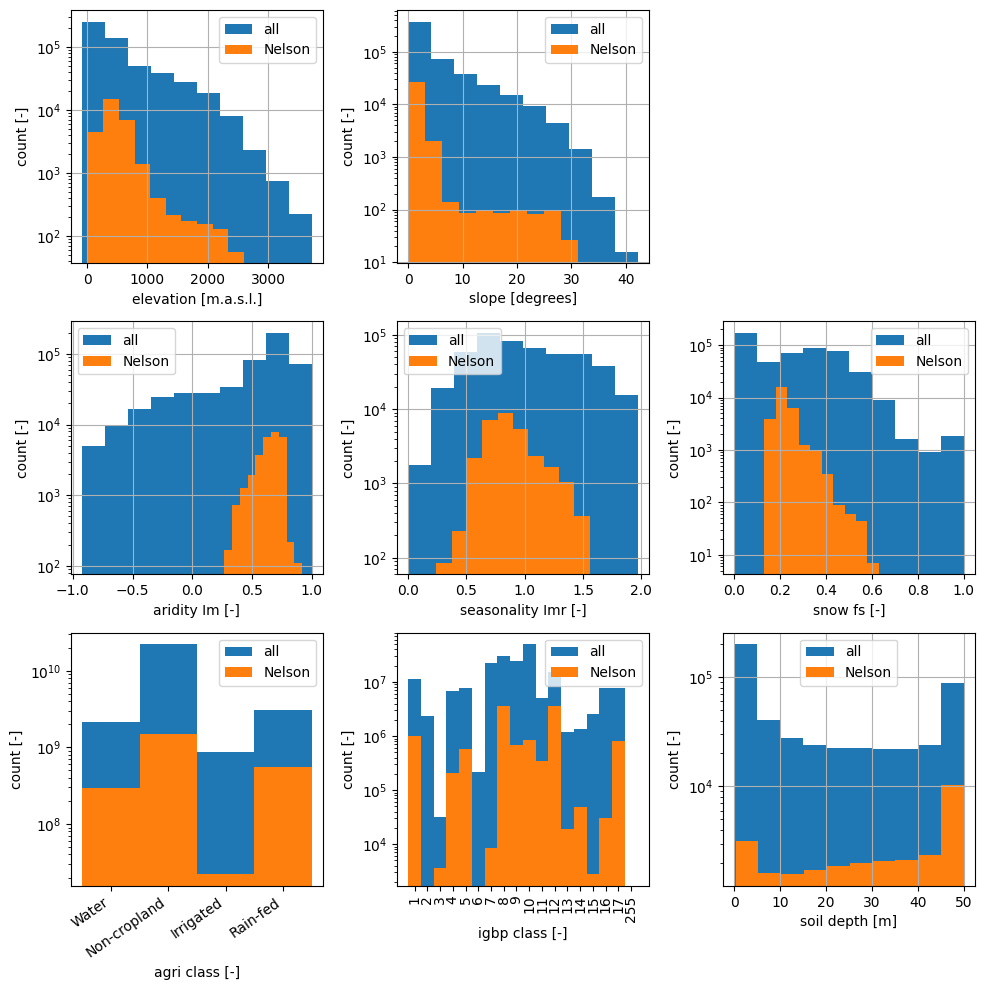

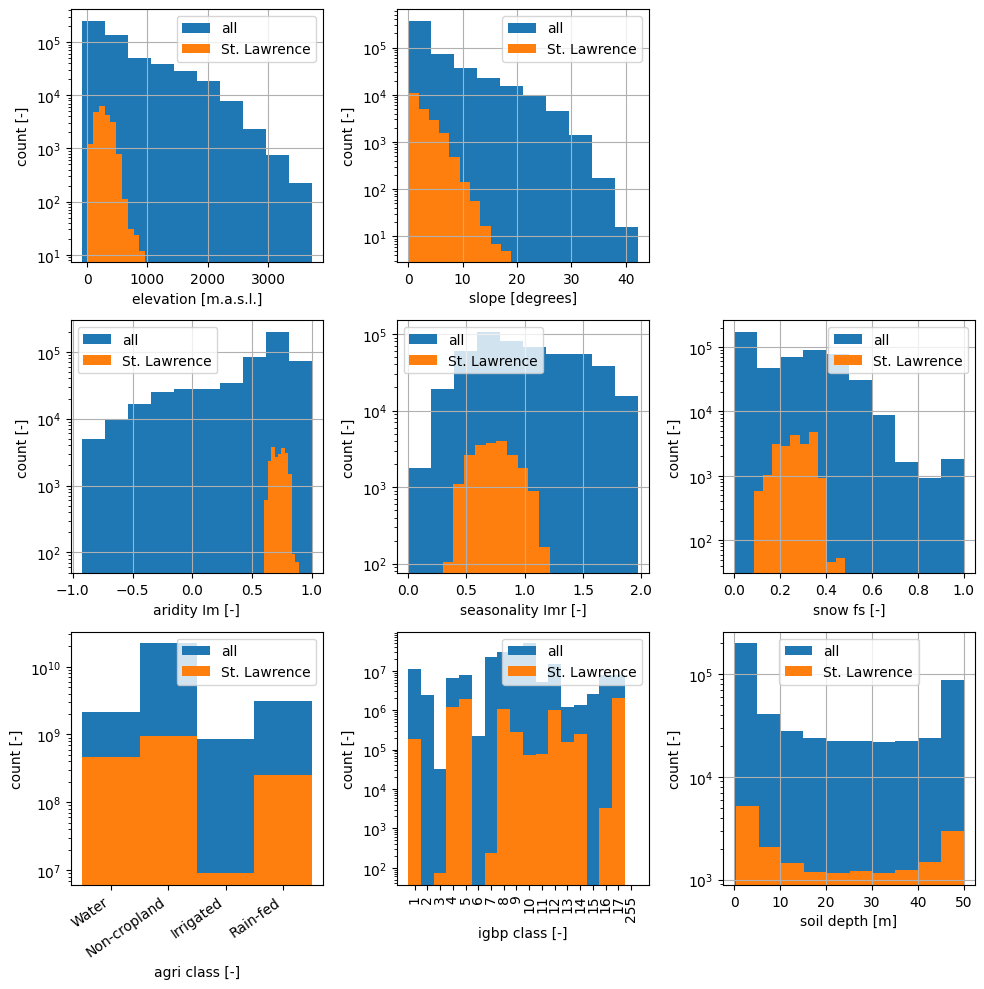

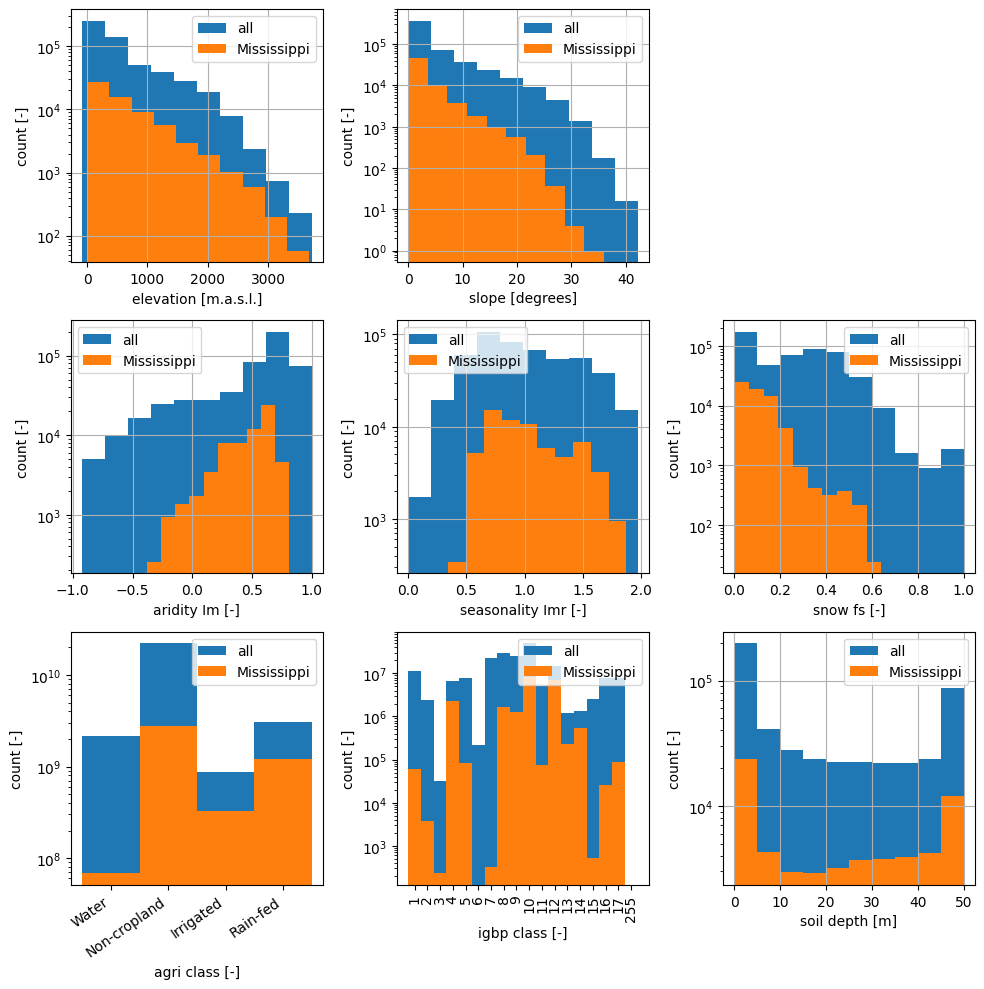

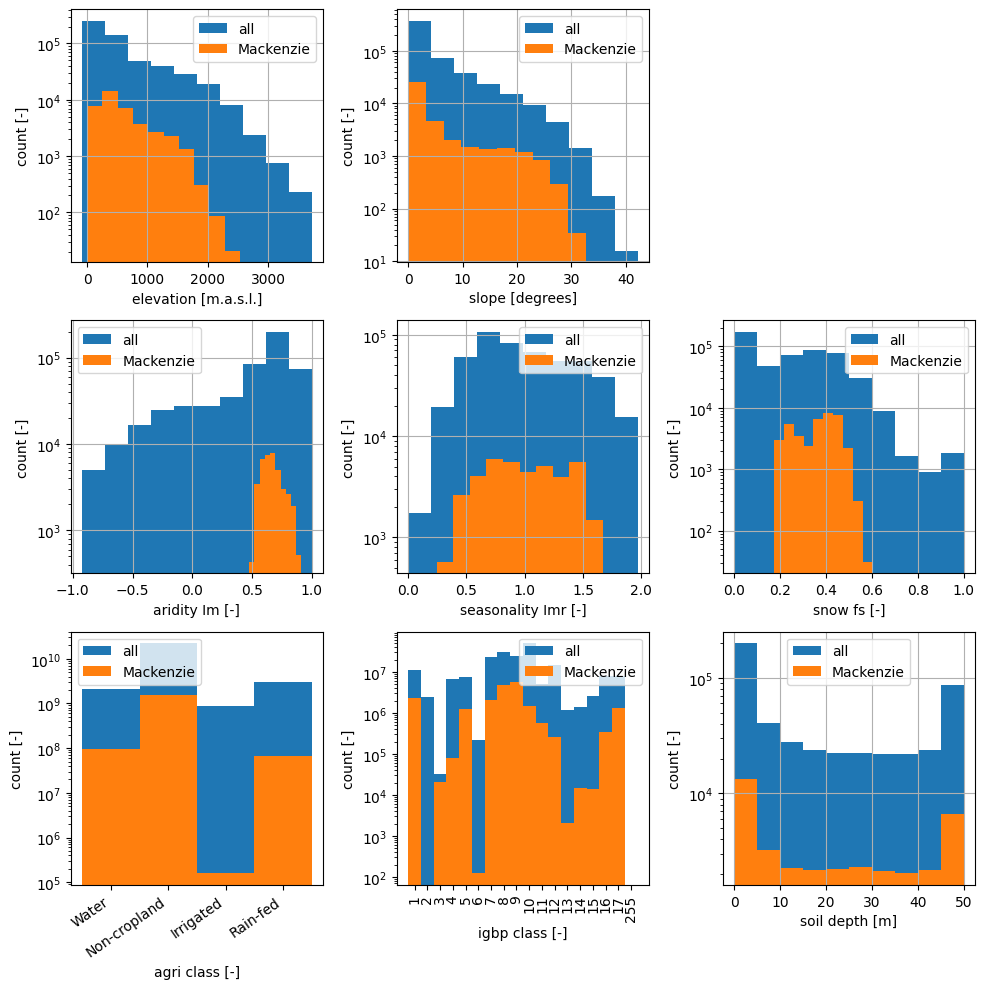

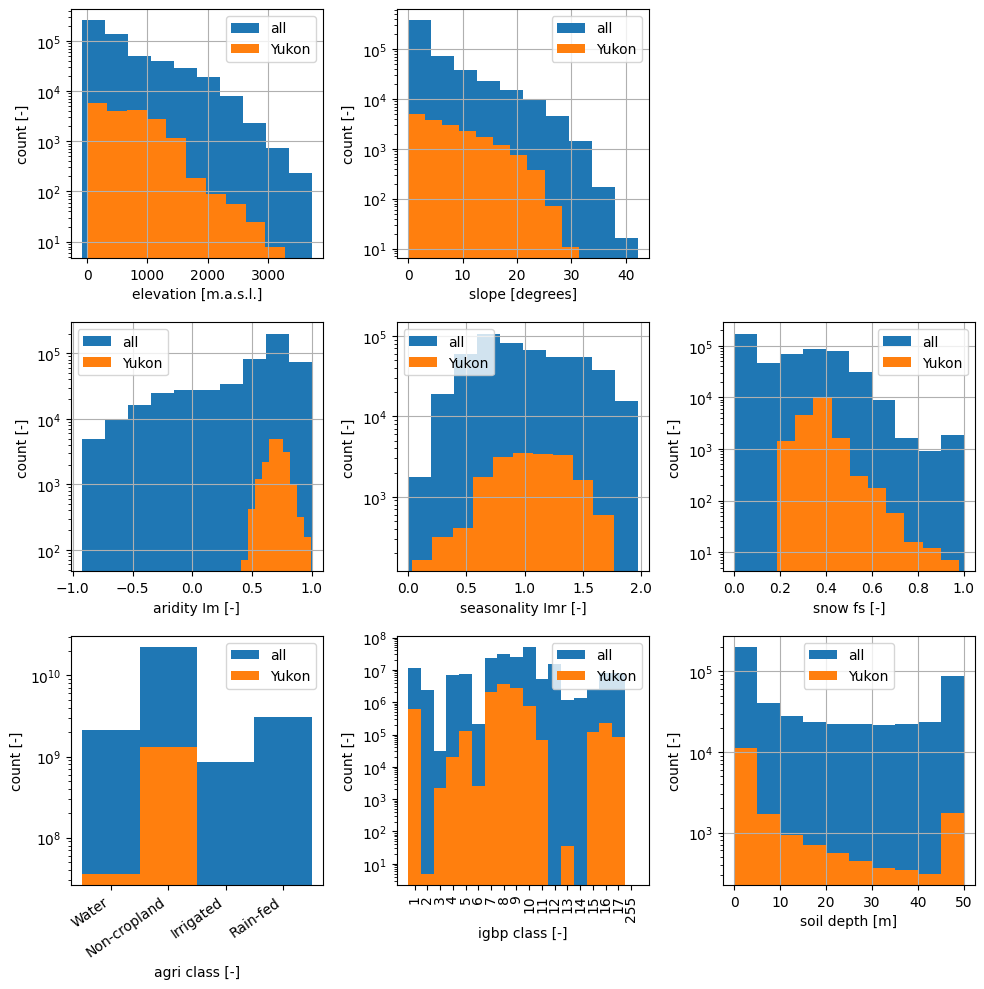

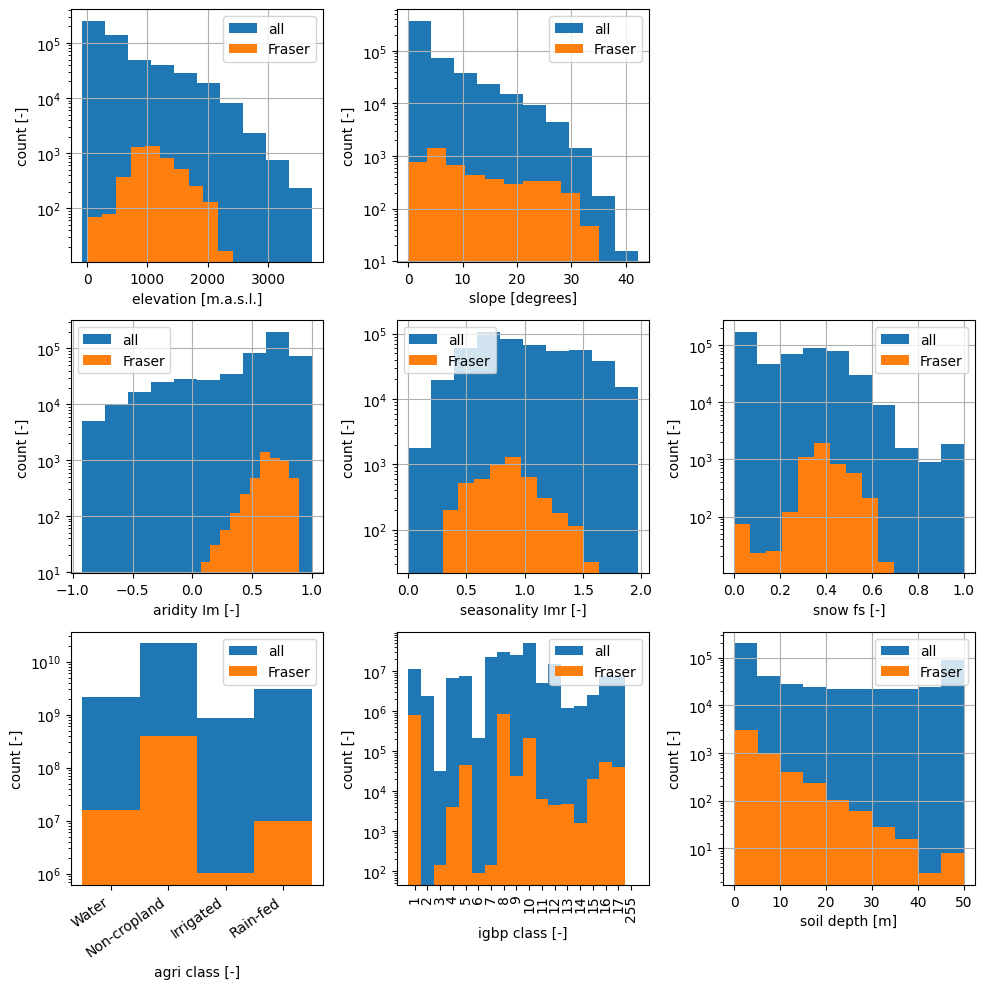

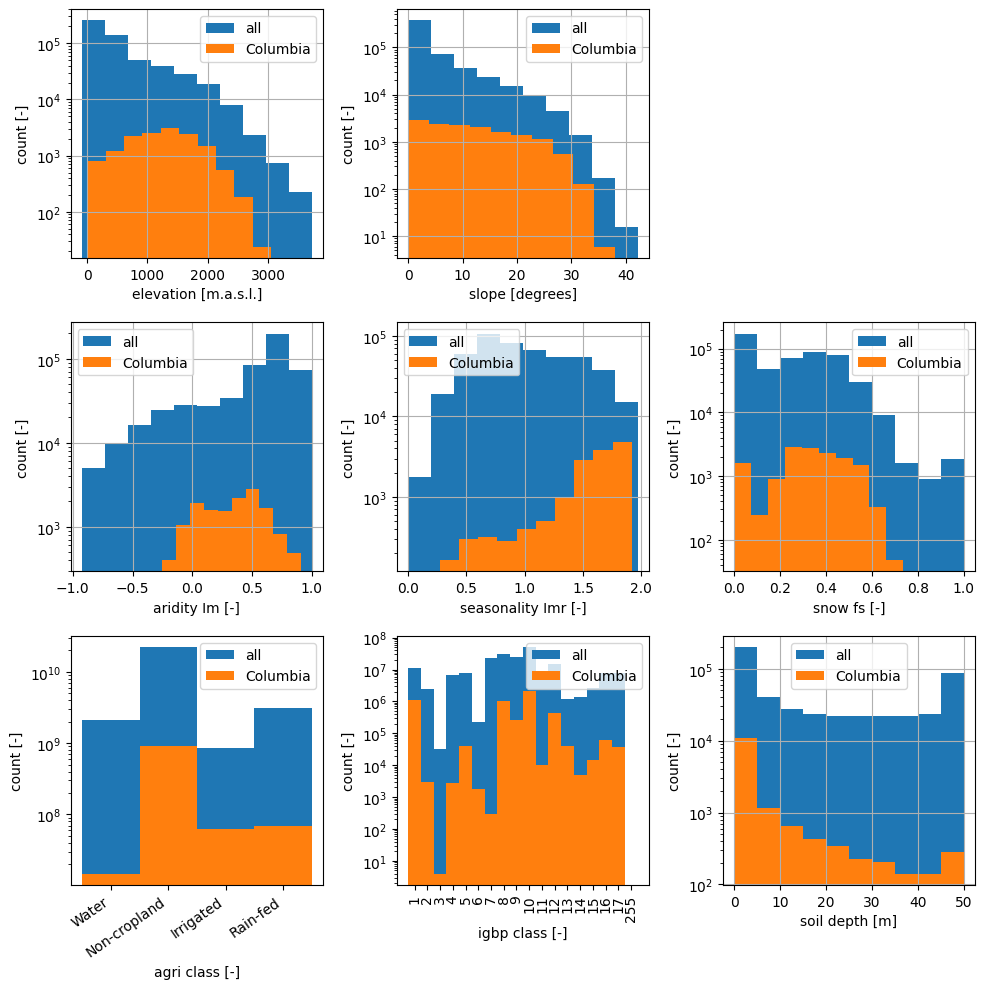

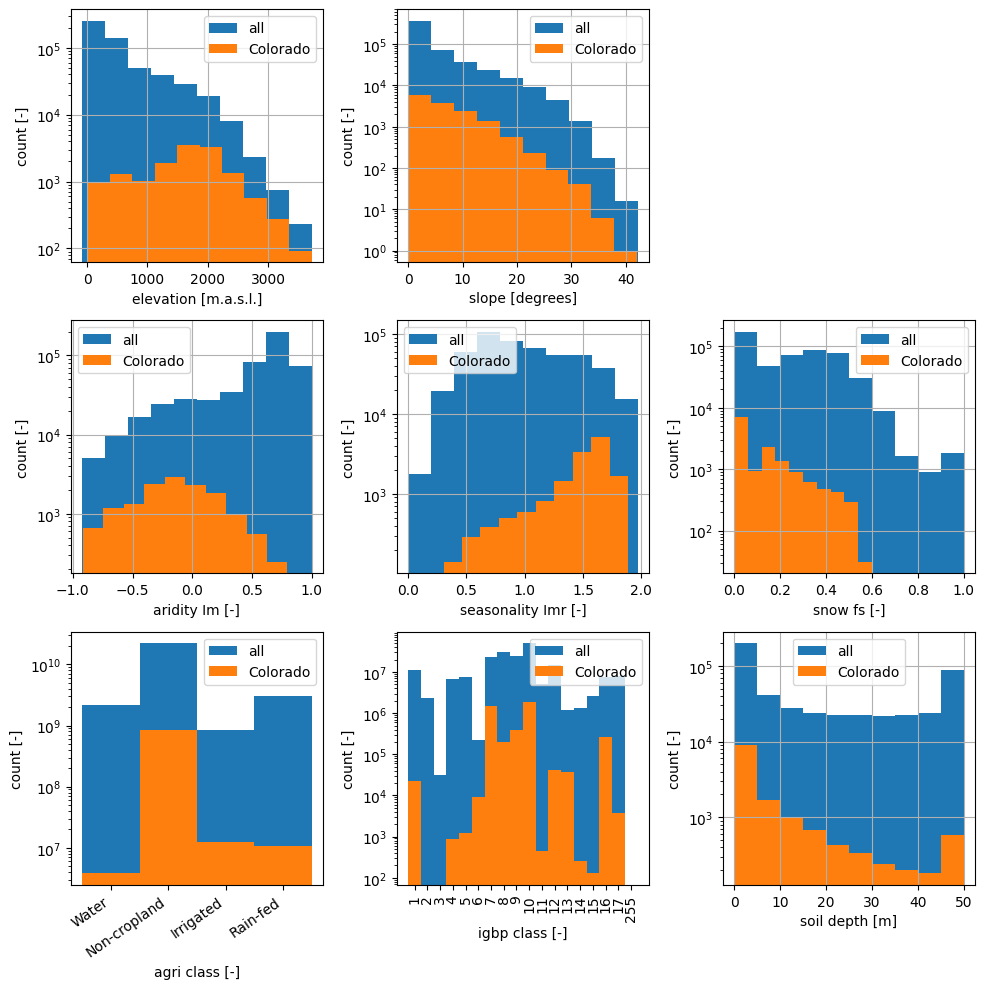

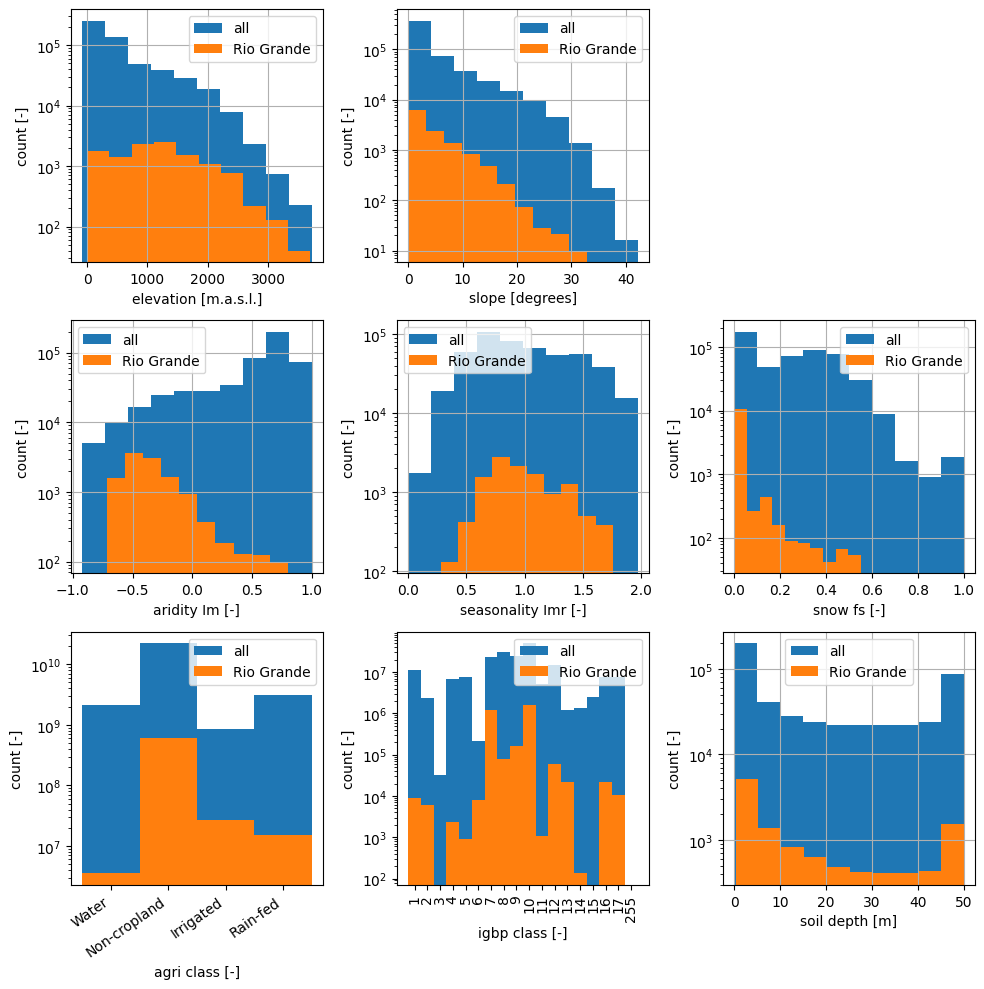

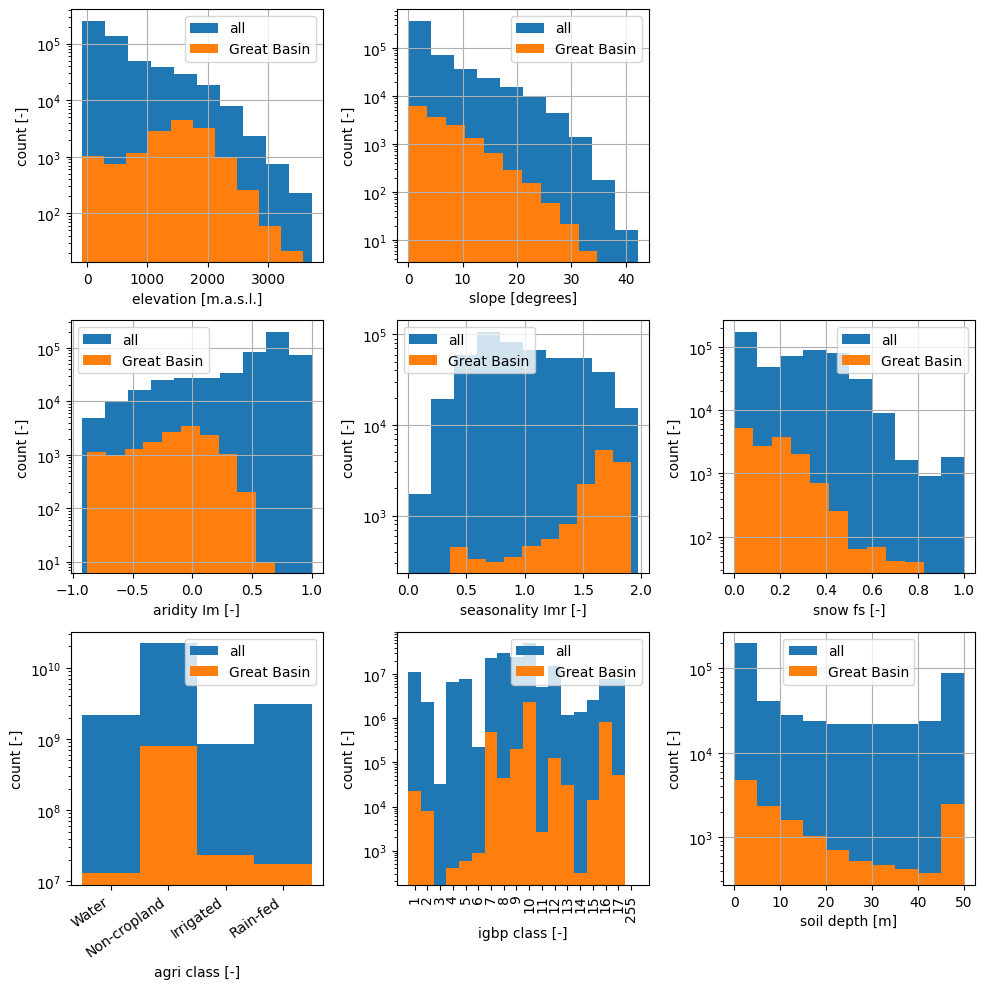

In [175]:
for pfaf_start,basin_name in basins:
    mask = stats['pfaf'].str.startswith(pfaf_start)
    print(f'{basin_name} has {mask.sum()} entries')

    fig, axs = plt.subplots(3,3,figsize=(10,10))
    axs = axs.flatten() # let's us use the enumerate index to select subplots
    for ix,(var,var_lbl) in enumerate(zip(variables,variables_leg)):
        ax = axs[ix]
        if var == '':
            ax.set_visible(False) # No data here, so hide the axis
            continue
        if (var == 'lgrip') or (var == 'igbp'): # Build a histogram for categorical data
            ax = plot_categorical_histogram(var, stats, ax, mask, basin_name)        
        else:  
            stats[var].hist(ax=ax, label='all')
            stats[mask][var].hist(ax=ax, label=basin_name)
        ax.legend()
        ax.set_yscale('log')
        ax.set_ylabel('count [-]')
        ax.set_xlabel(var_lbl)
    plt.tight_layout()
    basin_name = basin_name.replace(' ','')
    plt.savefig(save_path / f'descriptors_by_basin_{basin_name}.png', dpi=300, bbox_inches='tight')